# 1. Default Structure

In [17]:
import os
import re
from dataclasses import dataclass
from typing import Optional, List, Dict
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt


@dataclass
class ImageData:
    """Class to store parsed image data"""
    artwork: str          # e.g., "pixiv1"
    model: str            # e.g., "nbp-base" or "original"
    page_number: int      # e.g., 0, 1, 2, ...
    inference_time: Optional[float]  # e.g., 38.0 (None for original images)
    img: Image.Image      # PIL Image
    filepath: str         # Full path to the image
    
    def __repr__(self):
        return f"ImageData(artwork={self.artwork}, model={self.model}, page={self.page_number}, inference_time={self.inference_time})"


class ImageLoader:
    """Load and parse images from data directory"""
    
    # Pattern to extract page number from filename (flexible with underscore separation)
    # Matches patterns like: p0, p1, p10, etc. anywhere in underscore-separated parts
    PAGE_PATTERN = re.compile(r'p(\d+)')
    
    # Pattern to extract inference time (e.g., 38s, 45s)
    INFERENCE_PATTERN = re.compile(r'(\d+(?:\.\d+)?)s')
    
    def __init__(self, data_dir: str):
        """
        Initialize the loader with the data directory path.
        
        Args:
            data_dir: Path to the data directory (e.g., "data/")
        """
        self.data_dir = Path(data_dir)
        self.images: List[ImageData] = []
        
    def load_all(self) -> List[ImageData]:
        """Load all images from the data directory"""
        self.images = []
        
        if not self.data_dir.exists():
            raise ValueError(f"Data directory not found: {self.data_dir}")
        
        # Iterate through artwork folders (e.g., pixiv1)
        for artwork_dir in self.data_dir.iterdir():
            if not artwork_dir.is_dir() or artwork_dir.name.startswith('.'):
                continue
                
            artwork_name = artwork_dir.name
            
            # Iterate through model folders (e.g., nbp-base, original)
            for model_dir in artwork_dir.iterdir():
                if not model_dir.is_dir() or model_dir.name.startswith('.'):
                    continue
                    
                model_name = model_dir.name
                
                # Load all images in the model folder
                for img_file in model_dir.iterdir():
                    if img_file.suffix.lower() in ['.png', '.jpg', '.jpeg', '.webp']:
                        image_data = self._parse_image(img_file, artwork_name, model_name)
                        if image_data:
                            self.images.append(image_data)
        
        return self.images
    
    def _parse_image(self, filepath: Path, artwork: str, model: str) -> Optional[ImageData]:
        """Parse a single image file and extract metadata"""
        filename = filepath.stem  # filename without extension
        
        # Split by underscore for flexible parsing
        parts = filename.split('_')
        
        # Find page number from any part
        page_number = None
        for part in parts:
            match = self.PAGE_PATTERN.search(part)
            if match:
                page_number = int(match.group(1))
                break
        
        if page_number is None:
            print(f"Warning: Could not parse page number from {filepath}")
            return None
        
        # Find inference time (optional)
        inference_time = None
        for part in parts:
            match = self.INFERENCE_PATTERN.search(part)
            if match:
                inference_time = float(match.group(1))
                break
        
        # Load the image
        try:
            img = Image.open(filepath)
            img.load()  # Force load to catch any issues
        except Exception as e:
            print(f"Warning: Could not load image {filepath}: {e}")
            return None
        
        return ImageData(
            artwork=artwork,
            model=model,
            page_number=page_number,
            inference_time=inference_time,
            img=img,
            filepath=str(filepath)
        )
    
    def get_by_artwork(self, artwork: str) -> List[ImageData]:
        """Get all images for a specific artwork"""
        return [img for img in self.images if img.artwork == artwork]
    
    def get_by_model(self, model: str) -> List[ImageData]:
        """Get all images for a specific model"""
        return [img for img in self.images if img.model == model]
    
    def get_by_artwork_and_model(self, artwork: str, model: str) -> List[ImageData]:
        """Get all images for a specific artwork and model"""
        return [img for img in self.images if img.artwork == artwork and img.model == model]
    
    def get_artworks(self) -> List[str]:
        """Get list of all artwork names"""
        return list(set(img.artwork for img in self.images))
    
    def get_models(self, artwork: Optional[str] = None) -> List[str]:
        """Get list of all model names, optionally filtered by artwork"""
        if artwork:
            return list(set(img.model for img in self.images if img.artwork == artwork))
        return list(set(img.model for img in self.images))

In [18]:
# Load all images from data directory
loader = ImageLoader("data/")
loader.load_all()

# Show summary
print(f"Loaded {len(loader.images)} images")
print(f"Artworks: {loader.get_artworks()}")
print(f"Models: {loader.get_models()}")

# Show first few images info
for img in loader.images[:5]:
    print(img)

/Users/jzahnny/code/yonsei/deeplearning/colorization/.venv/lib/python3.11/site-packages/PIL/Image.py:3432: DecompressionBombWarning: Image size (161217300 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Loaded 46 images
Artworks: ['pixiv1']
Models: ['merged_33', 'nbp-base-kr', 'nbp-base', 'original', 'merged_22', 'manganinja', 'merged_55']
ImageData(artwork=pixiv1, model=merged_33, page=9, inference_time=None)
ImageData(artwork=pixiv1, model=merged_33, page=0, inference_time=None)
ImageData(artwork=pixiv1, model=original, page=16, inference_time=None)
ImageData(artwork=pixiv1, model=original, page=17, inference_time=None)
ImageData(artwork=pixiv1, model=original, page=15, inference_time=None)


# 2. Functions

## 2.1. `display_2col`

In [21]:
def display_2col(loader: ImageLoader, artwork: str, model1: str, model2: str, figsize: tuple = (12, 8)):
    """
    Display images side-by-side for comparison between two models.
    
    Args:
        loader: ImageLoader instance with loaded images
        artwork: Artwork name (e.g., "pixiv1")
        model1: First model name (displayed on left)
        model2: Second model name (displayed on right)
        figsize: Figure size for each comparison (width, height)
    """
    # Get images for both models
    images1 = loader.get_by_artwork_and_model(artwork, model1)
    images2 = loader.get_by_artwork_and_model(artwork, model2)
    
    # Create dictionaries by page number for easy lookup
    dict1: Dict[int, ImageData] = {img.page_number: img for img in images1}
    dict2: Dict[int, ImageData] = {img.page_number: img for img in images2}
    
    # Get all page numbers that exist in either model
    all_pages = sorted(set(dict1.keys()) | set(dict2.keys()))
    
    if not all_pages:
        print(f"No images found for artwork '{artwork}' with models '{model1}' or '{model2}'")
        return
    
    print(f"Comparing {len(all_pages)} pages for artwork '{artwork}'")
    print(f"Left: {model1} | Right: {model2}")
    print("-" * 50)
    
    # Display each page comparison
    for page in all_pages:
        fig, axes = plt.subplots(1, 2, figsize=figsize)
        
        # Left image (model1)
        if page in dict1:
            img_data1 = dict1[page]
            axes[0].imshow(img_data1.img)
            title1 = f"{model1} - Page {page}"
            if img_data1.inference_time is not None:
                title1 += f" ({img_data1.inference_time}s)"
            axes[0].set_title(title1)
        else:
            axes[0].text(0.5, 0.5, f"No image\n{model1} - Page {page}", 
                        ha='center', va='center', fontsize=14)
            axes[0].set_title(f"{model1} - Page {page} (missing)")
        axes[0].axis('off')
        
        # Right image (model2)
        if page in dict2:
            img_data2 = dict2[page]
            axes[1].imshow(img_data2.img)
            title2 = f"{model2} - Page {page}"
            if img_data2.inference_time is not None:
                title2 += f" ({img_data2.inference_time}s)"
            axes[1].set_title(title2)
        else:
            axes[1].text(0.5, 0.5, f"No image\n{model2} - Page {page}", 
                        ha='center', va='center', fontsize=14)
            axes[1].set_title(f"{model2} - Page {page} (missing)")
        axes[1].axis('off')
        
        plt.tight_layout()
        plt.show()


Comparing 18 pages for artwork 'pixiv1'
Left: original | Right: nbp-base
--------------------------------------------------


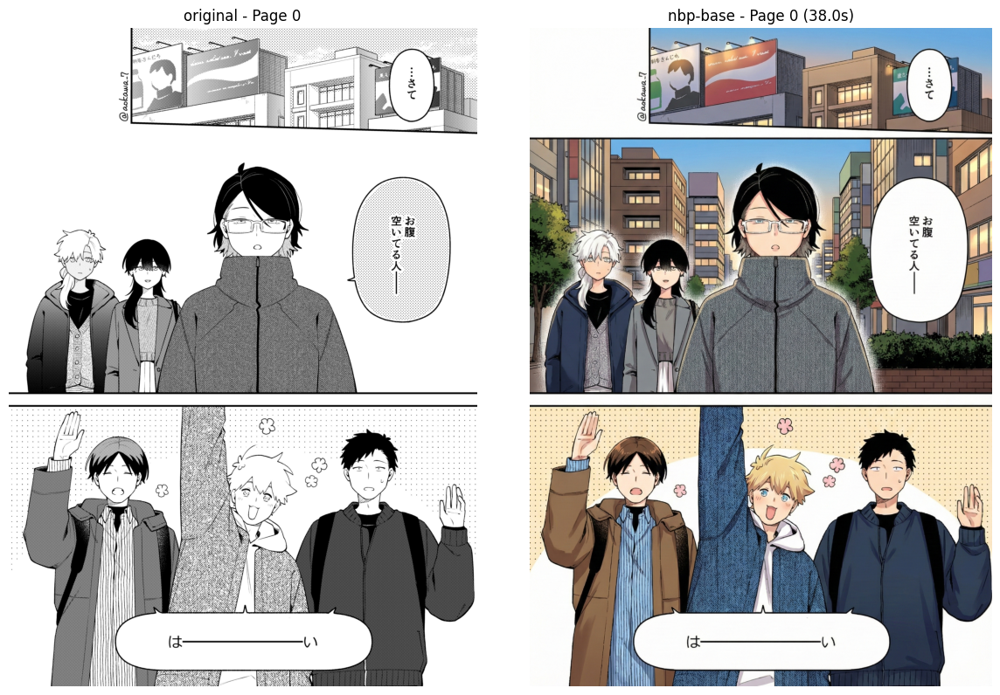

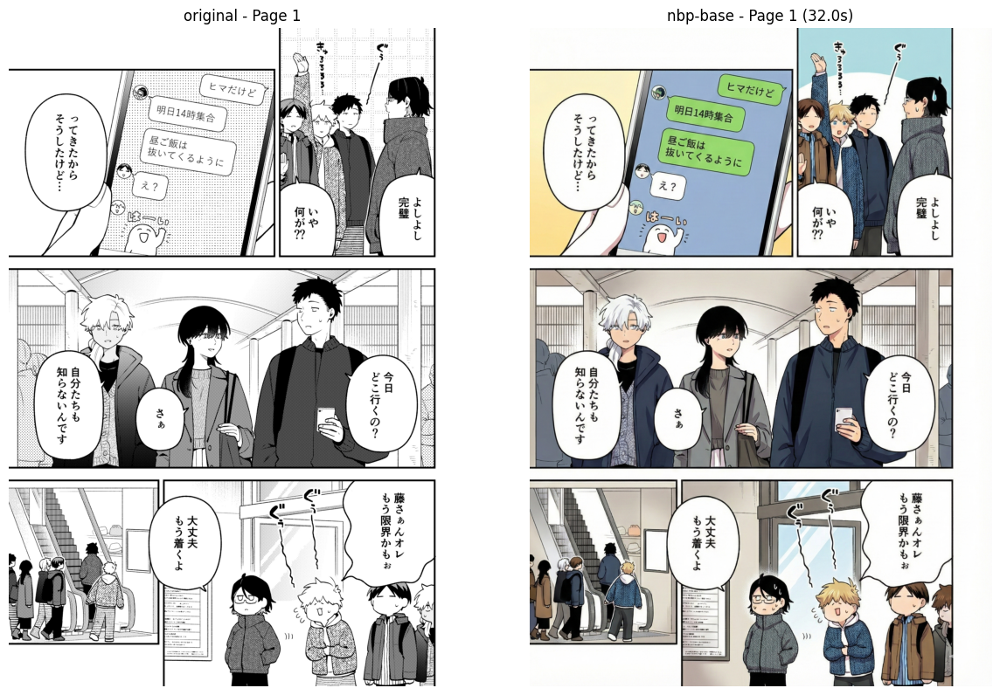

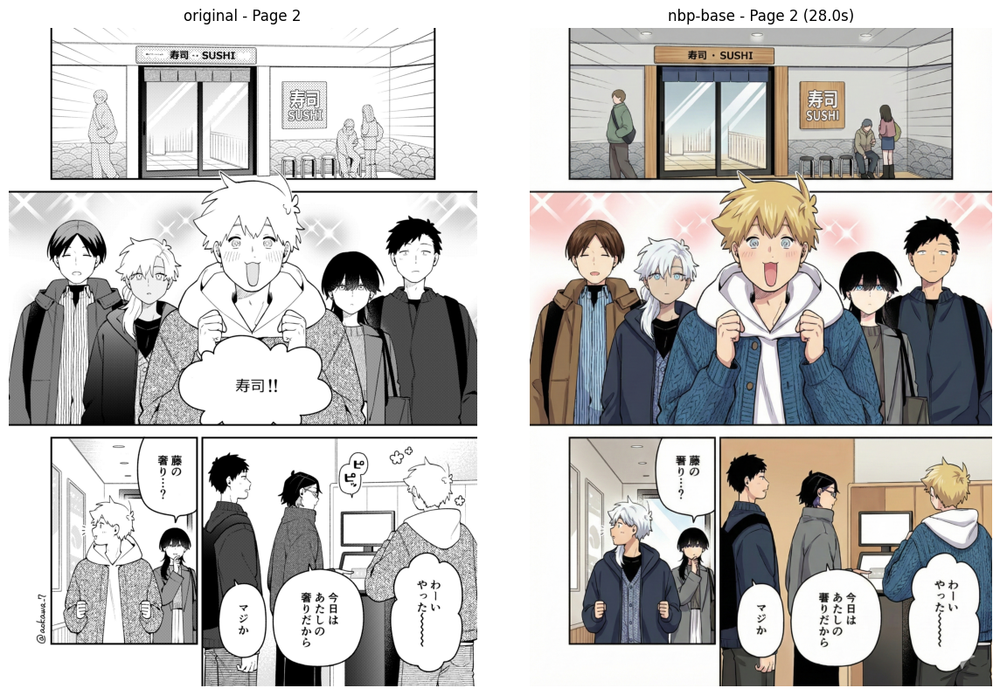

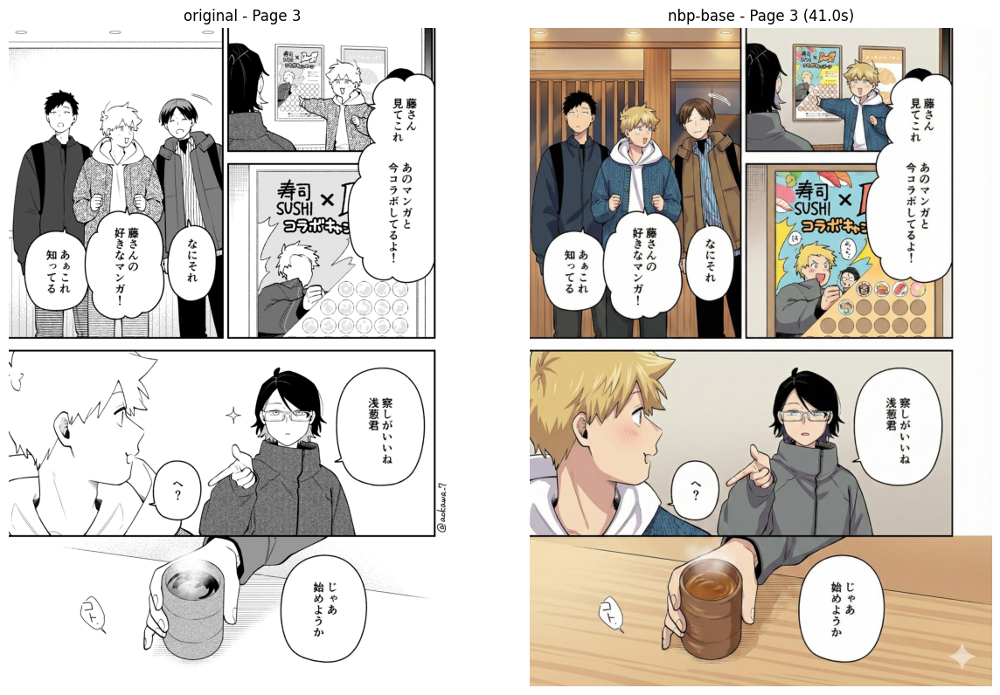

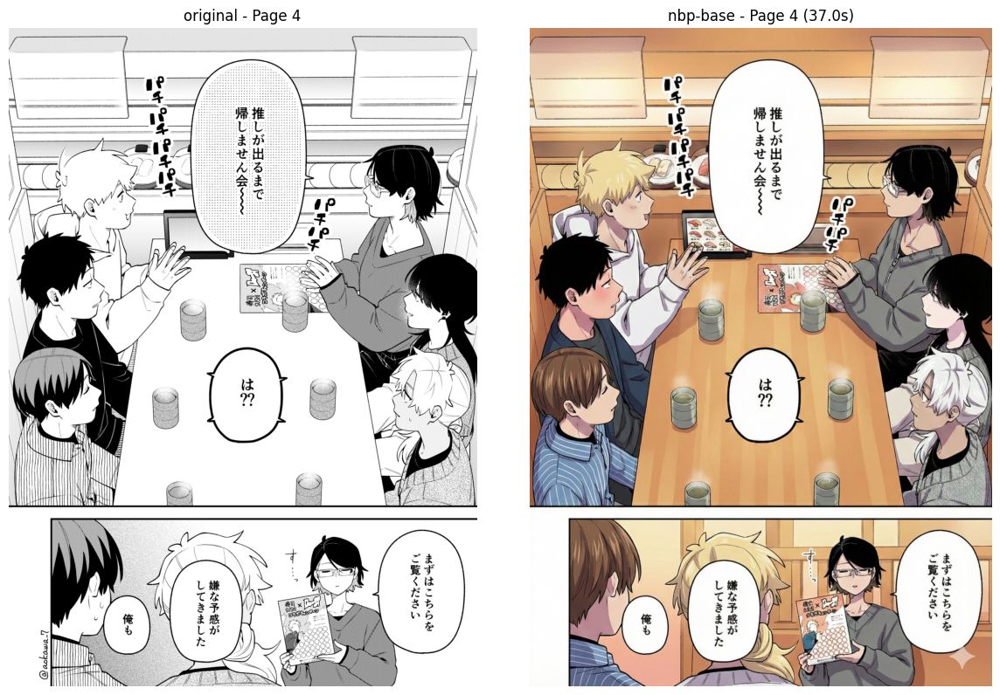

...

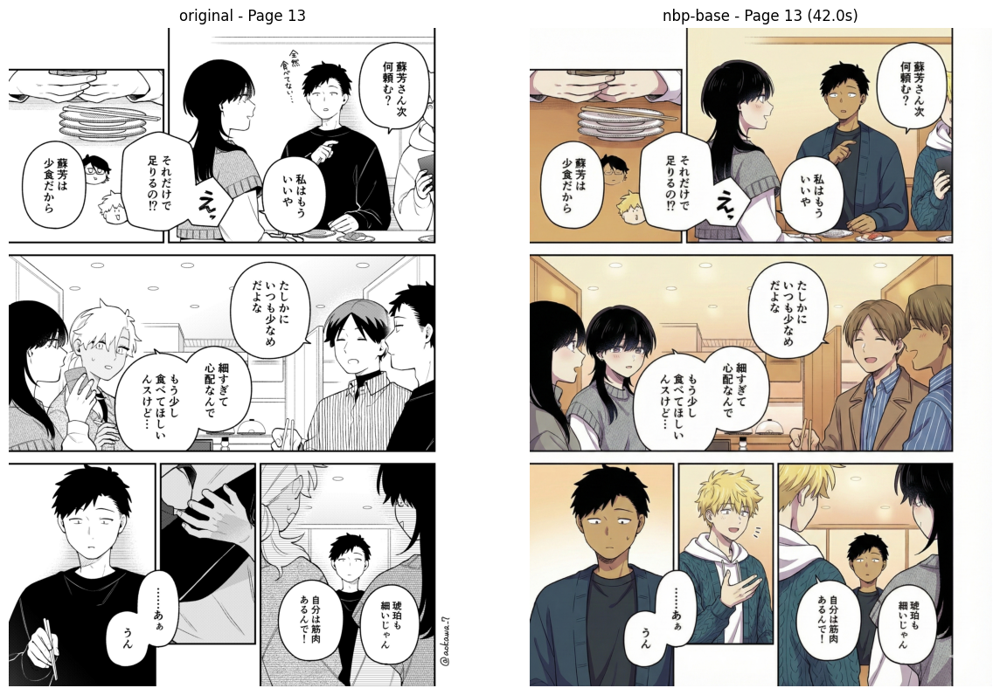

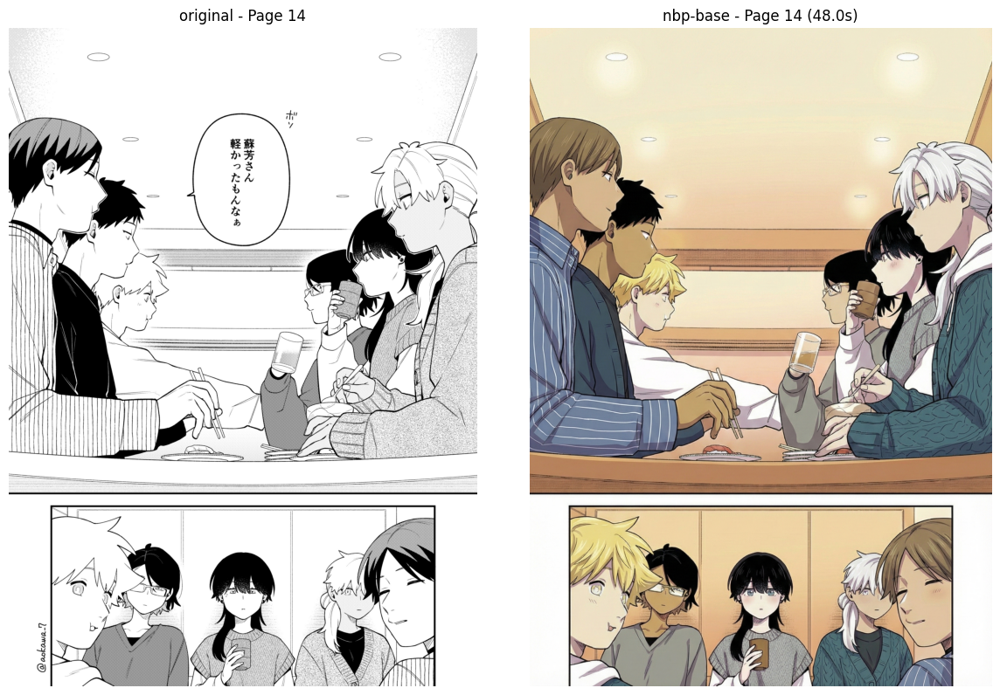

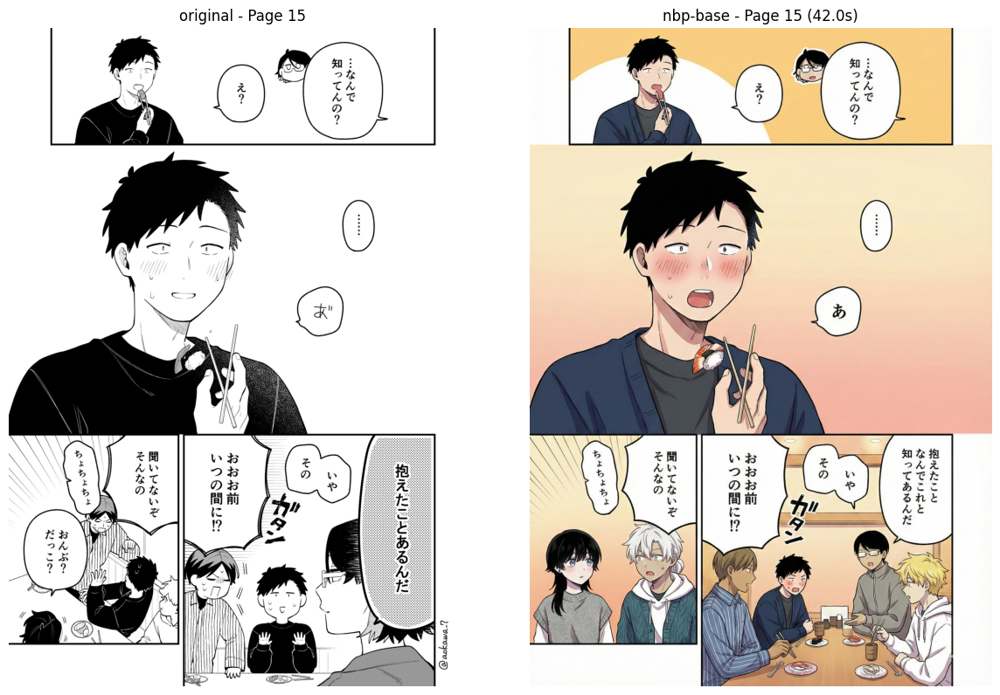

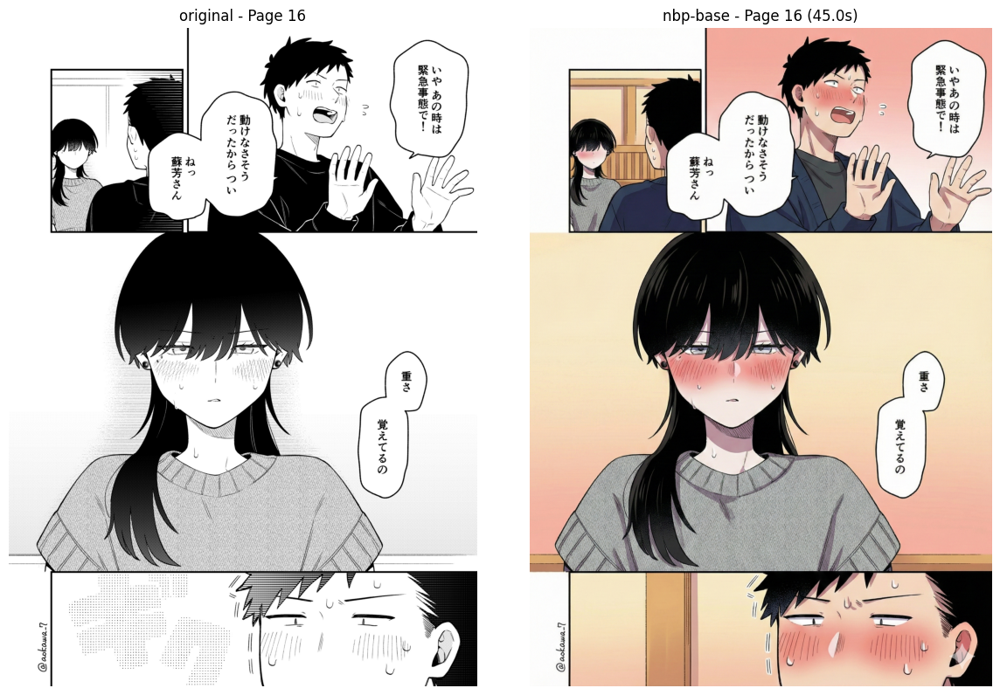

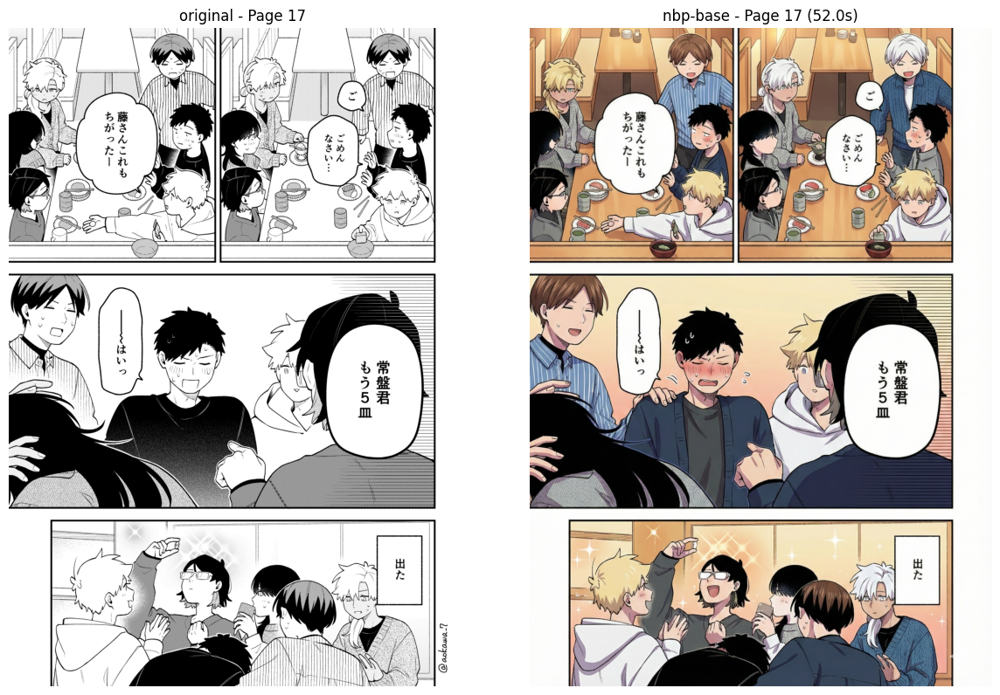

In [22]:
# Display side-by-side comparison of original vs nbp-base
display_2col(loader, "pixiv1", "original", "nbp-base")

## 2.2. `merge_and_save`

In [24]:
def merge_and_save(loader: ImageLoader, artwork: str, input_model: str, n_col: int, n_row: int, output_model: str, border: int = 0):
    """
    Merge images into a grid and save to output folder.
    
    Args:
        loader: ImageLoader instance with loaded images
        artwork: Artwork name (e.g., "pixiv1")
        input_model: Source model name (e.g., "original")
        n_col: Number of columns in the grid
        n_row: Number of rows in the grid
        output_model: Output folder name (e.g., "merged_34")
        border: Border width in pixels (black border between images)
    
    Output files will be named like: p0~11.png, p12~23.png, etc.
    Images are placed left-to-right, top-to-bottom. Empty cells are filled with white (#ffffff).
    """
    # Get images for the artwork and model
    images = loader.get_by_artwork_and_model(artwork, input_model)
    
    if not images:
        print(f"No images found for artwork '{artwork}' with model '{input_model}'")
        return
    
    # Sort by page number
    images_dict: Dict[int, ImageData] = {img.page_number: img for img in images}
    all_pages = sorted(images_dict.keys())
    
    if not all_pages:
        print("No pages found")
        return
    
    # Get image dimensions from first image (assume all images are same size)
    first_img = images_dict[all_pages[0]].img
    img_width, img_height = first_img.size
    
    # Calculate grid dimensions with border
    grid_width = img_width * n_col + border * (n_col + 1)
    grid_height = img_height * n_row + border * (n_row + 1)
    images_per_grid = n_col * n_row
    
    # Create output directory
    output_dir = loader.data_dir / artwork / output_model
    output_dir.mkdir(parents=True, exist_ok=True)
    
    # Process pages in chunks
    min_page = min(all_pages)
    max_page = max(all_pages)
    
    grid_idx = 0
    current_page = min_page
    
    while current_page <= max_page:
        # Calculate page range for this grid
        start_page = current_page
        end_page = current_page + images_per_grid - 1
        
        # Create black canvas (for border)
        grid_img = Image.new('RGB', (grid_width, grid_height), color=(0, 0, 0))
        
        # Fill grid with images
        for i in range(images_per_grid):
            page_num = current_page + i
            
            # Calculate position in grid (left-to-right, top-to-bottom)
            col = i % n_col
            row = i // n_col
            x = border + col * (img_width + border)
            y = border + row * (img_height + border)
            
            # Paste image if it exists, otherwise paste white
            if page_num in images_dict:
                img = images_dict[page_num].img
                # Convert to RGB if necessary (handle RGBA, L, etc.)
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                grid_img.paste(img, (x, y))
            else:
                # Fill empty cell with white
                white_cell = Image.new('RGB', (img_width, img_height), color=(255, 255, 255))
                grid_img.paste(white_cell, (x, y))
        
        # Save the grid
        actual_end = min(end_page, max_page)
        filename = f"p{start_page}~{actual_end}.png"
        output_path = output_dir / filename
        grid_img.save(output_path, 'PNG')
        print(f"Saved: {output_path}")
        
        current_page += images_per_grid
        grid_idx += 1
    
    print(f"\nDone! Saved {grid_idx} merged images to {output_dir}")

In [25]:
merge_and_save(loader, "pixiv1", "nbp-base", 3, 3, "merged_nbp-base_33", 10)

Saved: data/pixiv1/merged_nbp-base_33/p0~8.png
Saved: data/pixiv1/merged_nbp-base_33/p9~17.png

Done! Saved 2 merged images to data/pixiv1/merged_nbp-base_33


## 2.3. `plot_inference_time_chart`

In [19]:
def plot_inference_time_chart(loader: ImageLoader, artwork: str, model: str, figsize: tuple = (12, 6)):
    """
    Plot a bar chart of inference times by page number.
    
    Args:
        loader: ImageLoader instance with loaded images
        artwork: Artwork name (e.g., "pixiv1")
        model: Model name (e.g., "nbp-base")
        figsize: Figure size (width, height)
    """
    images = loader.get_by_artwork_and_model(artwork, model)
    
    if not images:
        print(f"No images found for artwork '{artwork}' with model '{model}'")
        return
    
    # Filter images with inference time and sort by page number
    images_with_time = [(img.page_number, img.inference_time) for img in images if img.inference_time is not None]
    
    if not images_with_time:
        print(f"No inference time data found for artwork '{artwork}' with model '{model}'")
        return
    
    images_with_time.sort(key=lambda x: x[0])
    
    pages = [x[0] for x in images_with_time]
    times = [x[1] for x in images_with_time]
    
    # Create bar chart
    fig, ax = plt.subplots(figsize=figsize)
    bars = ax.bar(pages, times, color='steelblue', edgecolor='black')
    
    ax.set_xlabel('Page Number', fontsize=12)
    ax.set_ylabel('Inference Time (s)', fontsize=12)
    ax.set_title(f'Inference Time per Page - {artwork} / {model}', fontsize=14)
    ax.set_xticks(pages)
    
    # Add value labels on top of bars
    for bar, time in zip(bars, times):
        ax.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5, 
                f'{time:.0f}s', ha='center', va='bottom', fontsize=9)
    
    # Add average line
    avg_time = sum(times) / len(times)
    ax.axhline(y=avg_time, color='red', linestyle='--', label=f'Average: {avg_time:.1f}s')
    ax.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Print summary
    print(f"Total pages: {len(times)}")
    print(f"Average inference time: {avg_time:.1f}s")
    print(f"Min: {min(times):.0f}s (Page {pages[times.index(min(times))]})")
    print(f"Max: {max(times):.0f}s (Page {pages[times.index(max(times))]})")

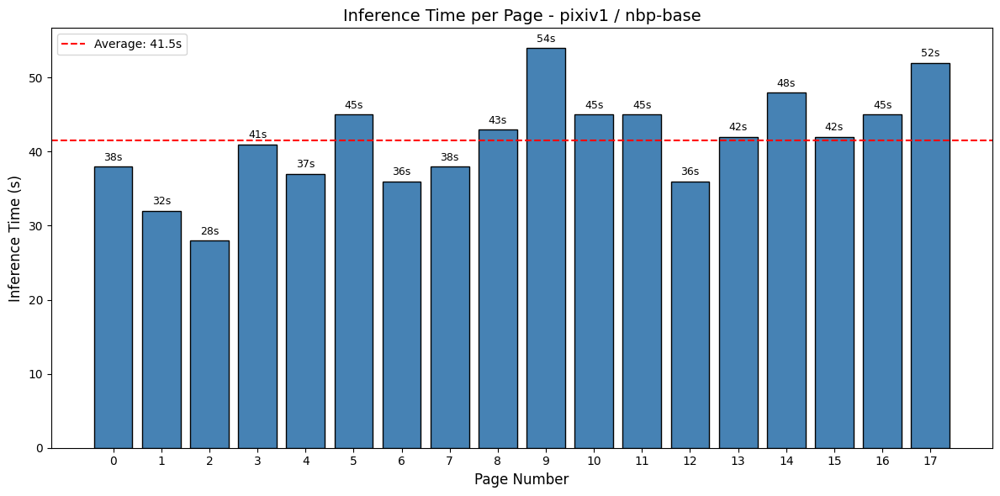

Total pages: 18
Average inference time: 41.5s
Min: 28s (Page 2)
Max: 54s (Page 9)


In [20]:
plot_inference_time_chart(loader, "pixiv1", "nbp-base")

# 3. Figure plotting

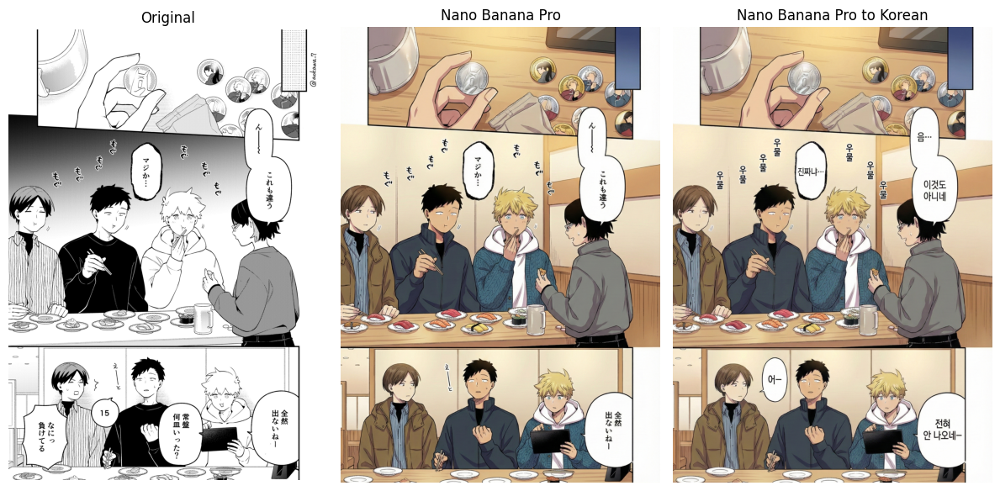

In [10]:
# Define 3 image paths
img_path1 = "data/pixiv1/original/136886858_p7.png"
img_path2 = "data/pixiv1/nbp-base/p7_38s.png"
img_path3 = "data/pixiv1/nbp-base-kr/p7_31s.png"

# Load images
img1 = Image.open(img_path1)
img2 = Image.open(img_path2)
img3 = Image.open(img_path3)

# Display 3 images in a 1x3 grid
fig, axes = plt.subplots(1, 3, figsize=(12, 6))

axes[0].imshow(img1)
axes[0].set_title("Original")
axes[0].axis('off')

axes[1].imshow(img2)
axes[1].set_title("Nano Banana Pro")
axes[1].axis('off')

axes[2].imshow(img3)
axes[2].set_title("Nano Banana Pro to Korean")
axes[2].axis('off')

plt.tight_layout()
plt.show()